In [10]:
import sys
from pathlib import Path


project_root = Path.cwd().parent
sys.path.append(str(project_root))

print("Added to path:", project_root)


Added to path: /Users/muhammadelmahdi/Prof_Ommer-Lab-Task/project


# Imports

In [11]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch
from ipywidgets import interact, IntSlider

### Importing the DDPM loader

In this, we import the DDPM loader and inference code that I prepared

In [12]:
from DDPM.model_loader import DDPM_Loader
from DDPM.inference import DDPMInference

### Importing the DDIM loader

In this, we import the DDIM loader and inference code that I prepared

In [13]:
from DDIM.model_loader import DDIM_Loader
from DDIM.inference import DDIMInference

### Importing the Latent Diffusion loader

In [14]:
from  Stable_diffusion.model_loader import Stable_Diffusion_Loader
from Stable_diffusion.inference import StableDiffusionInference

### Importing the flow matching loader

In this, we use sd3 rectified flow by diffusers

In [15]:
from flow_matching.model_loader import SD3FlowMatchingLoader
from flow_matching.inference import SD3FlowMatchingInference

# Inferencing the Models

### DDPM

In [16]:
stable_diffusion=DDPM_Loader(device="mps")
inference=DDPMInference(stable_diffusion)
intermediates_DDPM, image_final_DDPM = inference.run_inference( num_steps=1000)

Loading pipeline components...:   0%|          | 0/2 [00:00<?, ?it/s]

An error occurred while trying to fetch /Users/muhammadelmahdi/.cache/huggingface/hub/models--google--ddpm-cifar10-32/snapshots/267b167dc01f0e4e61923ea244e8b988f84deb80: Error no file named diffusion_pytorch_model.safetensors found in directory /Users/muhammadelmahdi/.cache/huggingface/hub/models--google--ddpm-cifar10-32/snapshots/267b167dc01f0e4e61923ea244e8b988f84deb80.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
100%|██████████| 1000/1000 [00:16<00:00, 58.95it/s]


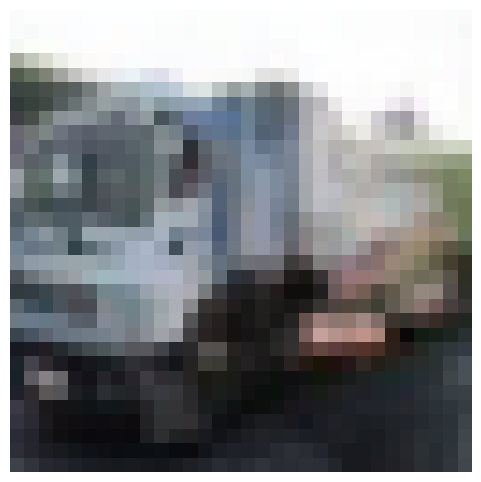

In [17]:

image_final_DDPM = image_final_DDPM.detach().cpu()

# Plot the image
image_final_DDPM = (image_final_DDPM + 1) / 2
image_final_DDPM = image_final_DDPM.clamp(0, 1)
image_final_DDPM_np = image_final_DDPM.squeeze(0).permute(1, 2, 0).numpy()

# Display
plt.figure(figsize=(6, 6))
plt.imshow(image_final_DDPM_np)
plt.axis("off")
plt.show()

In [18]:
intermediates_DDPM

[{'step': 0,
  'timestep': 999,
  'latent': tensor([[[[-1.5272,  0.9364,  0.6293,  ..., -0.0910,  0.9062,  0.5914],
            [ 0.8664, -2.0170, -0.3348,  ..., -0.7069, -1.4876,  1.2389],
            [ 1.2659, -2.1292,  0.4524,  ...,  0.0346, -1.5787,  0.0410],
            ...,
            [ 0.1172,  1.1453, -0.9734,  ...,  0.9526, -0.7416,  0.1241],
            [-2.7196,  1.5128, -0.0340,  ...,  0.5501, -0.5575, -1.4755],
            [ 1.7791,  0.6436, -0.6236,  ..., -0.7962, -0.1841, -1.8426]],
  
           [[-1.3044,  1.6927, -2.3172,  ...,  0.4641,  0.8057,  1.5306],
            [ 1.6372, -1.6766, -0.1122,  ..., -1.2698,  0.2726, -1.8699],
            [-1.9874,  1.6235,  0.7716,  ...,  0.7133, -0.3170,  0.3874],
            ...,
            [ 0.6189, -0.8699, -2.5964,  ...,  0.1663, -1.2220, -0.8207],
            [ 2.0906, -1.4654, -1.1538,  ...,  1.4690,  0.8605,  1.1899],
            [-0.4072, -2.9478,  1.7963,  ...,  0.0521,  2.2041, -0.3200]],
  
           [[ 0.3613, -0.312

### DDIM

In [19]:
loader = DDIM_Loader(device="mps")
infer = DDIMInference(loader, device="mps")


intermediates_DDIM, final_image_DDIM = infer.run_inference(num_steps=1000, eta=0.0)

Loading pipeline components...:   0%|          | 0/2 [00:00<?, ?it/s]

An error occurred while trying to fetch /Users/muhammadelmahdi/.cache/huggingface/hub/models--google--ddpm-cifar10-32/snapshots/267b167dc01f0e4e61923ea244e8b988f84deb80: Error no file named diffusion_pytorch_model.safetensors found in directory /Users/muhammadelmahdi/.cache/huggingface/hub/models--google--ddpm-cifar10-32/snapshots/267b167dc01f0e4e61923ea244e8b988f84deb80.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
100%|██████████| 1000/1000 [00:14<00:00, 69.04it/s]


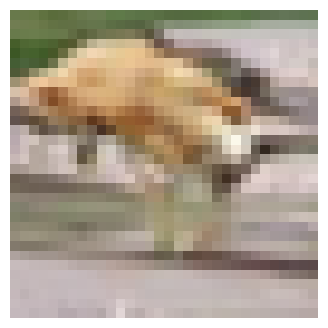

In [20]:
final_image_DDIM= final_image_DDIM.detach().cpu()
final_image_DDIM = (final_image_DDIM + 1) / 2       
final_image_DDIM = final_image_DDIM.clamp(0, 1)
final_image_DDIM_np = final_image_DDIM.squeeze(0).permute(1, 2, 0).numpy()

plt.figure(figsize=(4, 4))
plt.imshow(final_image_DDIM_np)
plt.axis("off")
plt.show()

In [21]:
intermediates_DDIM

[{'step': 0,
  'timestep': 999,
  'latent': tensor([[[[-0.7493,  0.2164,  1.2930,  ..., -0.5940, -1.8476,  0.2657],
            [ 1.5354, -0.5410,  0.0837,  ...,  1.1094, -2.0890,  0.3603],
            [ 0.5125, -0.0079,  0.2596,  ..., -0.3575,  0.0776, -0.6380],
            ...,
            [ 1.6430, -1.2458,  1.8170,  ...,  2.2582,  0.5433, -0.6539],
            [ 0.4283,  0.1823,  0.2525,  ...,  0.4737,  0.4045,  0.9145],
            [ 0.2616,  1.2317, -1.2348,  ..., -0.2136,  0.2112,  0.5465]],
  
           [[ 0.3473, -0.0879,  1.6509,  ..., -1.3808,  0.5007,  0.1162],
            [-1.0526,  0.6054,  0.7842,  ..., -0.2341,  0.1612,  0.3903],
            [ 1.0342,  0.4687,  0.2888,  ...,  1.1207,  1.5685,  0.2857],
            ...,
            [-0.0401, -1.6122, -0.1895,  ...,  0.0093, -0.0192, -0.7867],
            [ 0.3119, -0.9731, -0.2598,  ...,  0.6105, -0.5667, -0.1075],
            [-0.2274, -0.4487, -0.9858,  ..., -0.9740, -0.3937, -0.7353]],
  
           [[ 0.8523, -0.557

## Latent Diffusion

In [22]:
stable_diffusion=Stable_Diffusion_Loader(device="mps")
inference_stable_diffusion=StableDiffusionInference(stable_diffusion)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

/Users/muhammadelmahdi/Prof_Ommer-Lab-Task/project/Stable_diffusion/inference.py:19: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  (1, self.unet.in_channels, 64, 64),
100%|██████████| 1000/1000 [04:15<00:00,  3.91it/s]


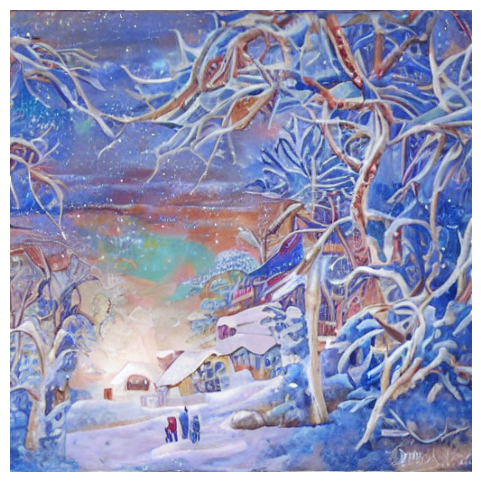

In [23]:
intermediates_latent_diffusion, final_latent = inference_stable_diffusion.run_inference("A snowy village in Winter", num_steps=999)

image_final_latent_diffusion = inference_stable_diffusion.decode_final_latent(final_latent)
image_final_latent_diffusion  = image_final_latent_diffusion .detach().cpu()

# Plot the image
image_final_latent_diffusion  = (image_final_latent_diffusion  + 1) / 2
image_final_latent_diffusion  = image_final_latent_diffusion .clamp(0, 1)
image_final_latent_diffusion_np = image_final_latent_diffusion .squeeze(0).permute(1, 2, 0).numpy()

# Display
plt.figure(figsize=(6, 6))
plt.imshow(image_final_latent_diffusion_np)
plt.axis("off")
plt.show()


In [24]:
intermediates_latent_diffusion

[{'step': 0,
  'timestep': 999,
  'latent': tensor([[[[ 1.9012e+00, -2.6865e-01,  1.5427e-01,  ...,  1.6181e+00,
             -1.3599e-01, -1.3267e+00],
            [-2.9663e-01, -4.6683e-01,  2.9474e-01,  ..., -7.1063e-01,
              1.6715e+00,  2.6160e-01],
            [-5.6255e-01, -2.6560e+00, -2.9860e-01,  ..., -3.0085e-01,
             -1.0875e+00,  5.2554e-01],
            ...,
            [-2.0256e+00, -3.5954e-01, -2.5820e-01,  ...,  9.5570e-01,
              6.3511e-01,  1.6362e+00],
            [-1.7012e+00, -1.3779e+00,  2.3620e-01,  ..., -1.0075e+00,
              1.7392e+00, -4.7956e-01],
            [ 1.1988e+00, -1.0927e+00, -6.7240e-01,  ...,  1.7818e-01,
             -5.2620e-01, -2.0005e-01]],
  
           [[-6.4307e-01, -4.3911e-01, -4.6492e-01,  ..., -1.8279e+00,
             -7.9752e-01,  2.2828e-02],
            [ 2.6774e-01, -9.2638e-01,  3.1552e-01,  ...,  2.5596e-01,
             -1.9265e+00, -1.6112e+00],
            [ 7.4103e-01, -2.8989e-02, -1.0188e+0

### Rectified Flow Matching (Stable Diffusion 3)

In [7]:

sd3_loader = SD3FlowMatchingLoader(device="mps")
sd3_infer = SD3FlowMatchingInference(sd3_loader, save_every=1)

intermediates_sd3, image_sd3 = sd3_infer.run_inference(
    prompt="a snowy German village at sunrise, highly detailed",
    negative_prompt="low quality, distorted",
    num_steps=20,
    guidance_scale=3.0,
    capture_steps=True,
)


Loading pipeline components...:   0%|          | 0/9 [00:00<?, ?it/s]

You set `add_prefix_space`. The tokenizer needs to be converted from the slow tokenizers
`torch_dtype` is deprecated! Use `dtype` instead!


Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

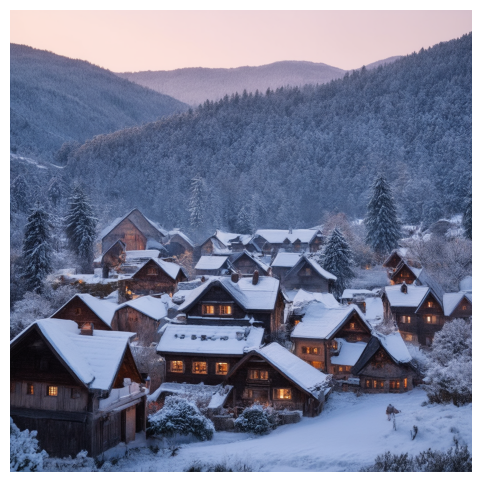

In [8]:
# Display
plt.figure(figsize=(6, 6))
plt.imshow(image_sd3)
plt.axis("off")
plt.show()


In [9]:
intermediates_sd3

[{'step': 0,
  'timestep': 1000,
  'latent': tensor([[[[-0.3569, -0.8613,  1.6338,  ..., -0.9028,  2.2305,  0.2676],
            [ 0.8711, -0.9810, -0.7437,  ..., -0.5859, -1.4707,  1.1201],
            [-0.8154,  0.1780,  0.3181,  ...,  0.6211,  0.7559,  0.3569],
            ...,
            [ 0.8809, -0.0855, -0.9639,  ...,  1.0713,  1.2021,  0.7129],
            [-0.6709, -0.3411, -0.0502,  ...,  0.2111, -0.7612, -1.5273],
            [-0.3621,  1.4268,  0.8550,  ...,  0.5747, -0.4888, -0.5161]],
  
           [[-0.5820,  0.3340,  1.2637,  ..., -0.5664, -1.3125, -0.0171],
            [ 0.2517, -0.1339, -0.2463,  ...,  1.4580, -0.6899, -1.2119],
            [ 1.3721,  1.1914,  0.2100,  ...,  0.2783,  0.8125, -0.0304],
            ...,
            [ 0.3081, -0.8970,  0.6211,  ..., -0.5508,  0.4692, -1.8262],
            [ 0.8608,  1.5781, -2.3691,  ...,  0.4929,  0.6289, -1.2383],
            [-0.4458,  0.4248,  0.9346,  ..., -1.5596,  0.1515, -1.4473]],
  
           [[ 0.0827,  0.96

# Experimental Analysis

### DDPM

In [25]:
intermediates_DDPM

[{'step': 0,
  'timestep': 999,
  'latent': tensor([[[[-1.5272,  0.9364,  0.6293,  ..., -0.0910,  0.9062,  0.5914],
            [ 0.8664, -2.0170, -0.3348,  ..., -0.7069, -1.4876,  1.2389],
            [ 1.2659, -2.1292,  0.4524,  ...,  0.0346, -1.5787,  0.0410],
            ...,
            [ 0.1172,  1.1453, -0.9734,  ...,  0.9526, -0.7416,  0.1241],
            [-2.7196,  1.5128, -0.0340,  ...,  0.5501, -0.5575, -1.4755],
            [ 1.7791,  0.6436, -0.6236,  ..., -0.7962, -0.1841, -1.8426]],
  
           [[-1.3044,  1.6927, -2.3172,  ...,  0.4641,  0.8057,  1.5306],
            [ 1.6372, -1.6766, -0.1122,  ..., -1.2698,  0.2726, -1.8699],
            [-1.9874,  1.6235,  0.7716,  ...,  0.7133, -0.3170,  0.3874],
            ...,
            [ 0.6189, -0.8699, -2.5964,  ...,  0.1663, -1.2220, -0.8207],
            [ 2.0906, -1.4654, -1.1538,  ...,  1.4690,  0.8605,  1.1899],
            [-0.4072, -2.9478,  1.7963,  ...,  0.0521,  2.2041, -0.3200]],
  
           [[ 0.3613, -0.312

In [182]:
def extract_latent_trajectory(intermediates):
    
    latents = []
    timesteps = []

    for step in intermediates:
        latents.append(step["latent"])   # (1, C, H, W)
        timesteps.append(step["timestep"])

    traj = torch.stack(latents, dim=0)   # (T, 1, C, H, W)
    timesteps = torch.tensor(timesteps)

    return traj, timesteps


In [251]:
traj_ddpm, timesteps_ddpm = extract_latent_trajectory(intermediates_DDPM)

print("Trajectory shape:", traj_ddpm.shape)
print("Timesteps (first 5):", timesteps_ddpm[:5])


Trajectory shape: torch.Size([1000, 1, 3, 32, 32])
Timesteps (first 5): tensor([999, 998, 997, 996, 995])


In [252]:
traj_ddpm

tensor([[[[[-1.5272e+00,  9.3638e-01,  6.2925e-01,  ..., -9.0977e-02,
             9.0621e-01,  5.9138e-01],
           [ 8.6643e-01, -2.0170e+00, -3.3484e-01,  ..., -7.0689e-01,
            -1.4876e+00,  1.2389e+00],
           [ 1.2659e+00, -2.1292e+00,  4.5236e-01,  ...,  3.4647e-02,
            -1.5787e+00,  4.0998e-02],
           ...,
           [ 1.1718e-01,  1.1453e+00, -9.7338e-01,  ...,  9.5256e-01,
            -7.4163e-01,  1.2410e-01],
           [-2.7196e+00,  1.5128e+00, -3.3982e-02,  ...,  5.5010e-01,
            -5.5751e-01, -1.4755e+00],
           [ 1.7791e+00,  6.4362e-01, -6.2361e-01,  ..., -7.9622e-01,
            -1.8414e-01, -1.8426e+00]],

          [[-1.3044e+00,  1.6927e+00, -2.3172e+00,  ...,  4.6411e-01,
             8.0569e-01,  1.5306e+00],
           [ 1.6372e+00, -1.6766e+00, -1.1219e-01,  ..., -1.2698e+00,
             2.7259e-01, -1.8699e+00],
           [-1.9874e+00,  1.6235e+00,  7.7162e-01,  ...,  7.1330e-01,
            -3.1703e-01,  3.8744e-01],
 

In [253]:
traj_ddim,timesteps_ddim=extract_latent_trajectory(intermediates_DDIM)

In [254]:

print("Trajectory shape:", traj_ddim.shape)
print("Timesteps (first 5):", timesteps_ddim[:5])

Trajectory shape: torch.Size([1000, 1, 3, 32, 32])
Timesteps (first 5): tensor([999, 998, 997, 996, 995])


In [255]:
intermediates_DDIM

[{'step': 0,
  'timestep': 999,
  'latent': tensor([[[[-0.7493,  0.2164,  1.2930,  ..., -0.5940, -1.8476,  0.2657],
            [ 1.5354, -0.5410,  0.0837,  ...,  1.1094, -2.0890,  0.3603],
            [ 0.5125, -0.0079,  0.2596,  ..., -0.3575,  0.0776, -0.6380],
            ...,
            [ 1.6430, -1.2458,  1.8170,  ...,  2.2582,  0.5433, -0.6539],
            [ 0.4283,  0.1823,  0.2525,  ...,  0.4737,  0.4045,  0.9145],
            [ 0.2616,  1.2317, -1.2348,  ..., -0.2136,  0.2112,  0.5465]],
  
           [[ 0.3473, -0.0879,  1.6509,  ..., -1.3808,  0.5007,  0.1162],
            [-1.0526,  0.6054,  0.7842,  ..., -0.2341,  0.1612,  0.3903],
            [ 1.0342,  0.4687,  0.2888,  ...,  1.1207,  1.5685,  0.2857],
            ...,
            [-0.0401, -1.6122, -0.1895,  ...,  0.0093, -0.0192, -0.7867],
            [ 0.3119, -0.9731, -0.2598,  ...,  0.6105, -0.5667, -0.1075],
            [-0.2274, -0.4487, -0.9858,  ..., -0.9740, -0.3937, -0.7353]],
  
           [[ 0.8523, -0.557

In [256]:
traj_ddim

tensor([[[[[-0.7493,  0.2164,  1.2930,  ..., -0.5940, -1.8476,  0.2657],
           [ 1.5354, -0.5410,  0.0837,  ...,  1.1094, -2.0890,  0.3603],
           [ 0.5125, -0.0079,  0.2596,  ..., -0.3575,  0.0776, -0.6380],
           ...,
           [ 1.6430, -1.2458,  1.8170,  ...,  2.2582,  0.5433, -0.6539],
           [ 0.4283,  0.1823,  0.2525,  ...,  0.4737,  0.4045,  0.9145],
           [ 0.2616,  1.2317, -1.2348,  ..., -0.2136,  0.2112,  0.5465]],

          [[ 0.3473, -0.0879,  1.6509,  ..., -1.3808,  0.5007,  0.1162],
           [-1.0526,  0.6054,  0.7842,  ..., -0.2341,  0.1612,  0.3903],
           [ 1.0342,  0.4687,  0.2888,  ...,  1.1207,  1.5685,  0.2857],
           ...,
           [-0.0401, -1.6122, -0.1895,  ...,  0.0093, -0.0192, -0.7867],
           [ 0.3119, -0.9731, -0.2598,  ...,  0.6105, -0.5667, -0.1075],
           [-0.2274, -0.4487, -0.9858,  ..., -0.9740, -0.3937, -0.7353]],

          [[ 0.8523, -0.5575, -0.9355,  ...,  0.6722, -0.1221, -1.2020],
           [ 0.

In [257]:
traj_latent, timesteps_latent = extract_latent_trajectory(intermediates_latent_diffusion)

print("Trajectory shape:", traj_latent.shape)
print("Timesteps (first 5):", timesteps_latent[:5])

Trajectory shape: torch.Size([1000, 1, 4, 64, 64])
Timesteps (first 5): tensor([999, 998, 998, 997, 996])


In [258]:
traj_sd3,timesteps_sd3=extract_latent_trajectory(intermediates_sd3)
print("Trajectory Shape",traj_sd3.shape)
print("Timesteps",timesteps_sd3)

Trajectory Shape torch.Size([20, 1, 16, 128, 128])
Timesteps tensor([1000,  981,  962,  941,  918,  894,  867,  837,  805,  770,  730,  687,
         638,  582,  520,  447,  364,  266,  149,    8])


## Important Note

For the experiments below, please note that:

 - **Flow Matching (SD3)**: It's important to note that the result of flow matching is not directly comparable to diffusion models due to the variety in inference steps.

For **DDPM, DDIM, and latent diffusion**, we use **1000 inference steps**, so each reverse step corresponds to a single timestep decrement. However, for the the **flow matching model**, we had to limit it to **~20 inference steps** due to hardware constraints. Accordingly, each step is a much larger interval in time. So the comparison is not fair as is.

## Trajectory Length in Reverse Diffusion Time

Since diffusion models inference work on the idea of starting from pure noise at x_T until we go back to the image at x_0 following the process:

x_T → x_{T-1} → ... → x_0

In this experiment, I tried to see how the sampler of each model move in the latent space. I tried to measure the  **trajectory length** which is in our definition the accumulated Euclidean displacement between consecutive steps:

Trajectory length = Σ || x_{t-1} − x_t ||₂
So we compute the norm over all channels and spatial dimensions.

This shows how direct the sampling path is. It's important to note that diffusion models are trained to predict noise at each timestep. However, different samplers have different trajectories during inference. In this experiment, I try to provide a simple geometric way to compare these behaviors.


In [108]:
def trajectory_length(traj):
    diffs = traj[1:] - traj[:-1]  # (T-1, 1, C, H, W)
    step_norms = torch.linalg.vector_norm(
        diffs, dim=(2, 3, 4)
    )  # (T-1, 1)
    return step_norms.sum().item()


In [109]:
print("DDPM length:", trajectory_length(traj_ddpm))
print("DDIM length:", trajectory_length(traj_ddim))
print("Latent Diffusion Length:",trajectory_length(traj_latent))


DDPM length: 5262.70849609375
DDIM length: 56.66462707519531
Latent Diffusion Length: 88.52547454833984


In [110]:
print("FM length:", trajectory_length(traj_sd3))


FM length: 623.5


As mentioned earlier, we computed the trajectory length by summing the Euclidean displacement. The results show that:

- **DDPM**: very large trajectory length  
- **DDIM**: significantly shorter trajectory length  
- **Latent Diffusion (Stable Diffusion)**: slightly longer than DDIM  
- **Flow Matching (SD3)**: It's important to note that the result of flow matching is not directly comparable to diffusion models due to the variety in inference steps. However, since this metric measures the total distance, it's important to consider that FM showed intermediate total displacement.

For **DDPM, DDIM, and latent diffusion**, we use **1000 inference steps**, so each reverse step corresponds to a single timestep decrement. However, for the the **flow matching model**, we had to limit it to **~20 inference steps** due to hardware constraints. Accordingly, each step is a much larger interval in time. So the comparison is not fair as is.

Despite this experimental limitation, the results show clear differences in how probalistic diffusion, deterministic diffusion, latent diffusion and flow-based models.



**DDPM exhibits the highest trajectory length:** Due to the stochastic nature of DDPM, there is more of random exploration in process which makes sense why DDPM has the highest trajectory length.

**DDIM has a significantly shorter trajectory:** By setting η = 0, the deterministic nature of the diffusion model leads to a smoother and more directed path which leads to shorter length.

**Latent diffusion shows slightly larger trajectory length than DDIM.:** this might be resulting from the latent-space geometry as the latent diffusion models don't operate in pixel space but rather in a latent space.  

**Flow matching:**  As mentioned earlier, due to the lower inference steps, each inference step has higher time interval which makes it unfair to compare the flow matching model to the diffusion model. However, since this metric measures the total distance, it's important to consider that FM showed intermediate total displacement.


### Per-Step Displacements Norm of intermediate Trajectories

After analyzing the total trajectory length, in this experiment we aim to show how the per-step displacement varies by time during the denoising process.



In [191]:
def step_displacements(traj):
    diffs = traj[1:] - traj[:-1]  # (T-1, 1, C, H, W)
    disp = torch.linalg.vector_norm(
        diffs, dim=(2, 3, 4)
    )  # (T-1, 1)
    return disp.squeeze(1)        # (T-1,)


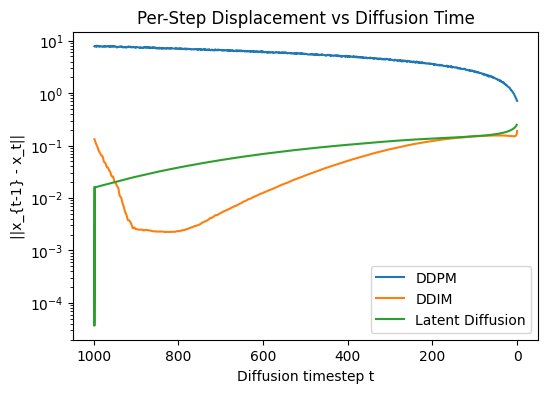

In [196]:
disp_ddpm = step_displacements(traj_ddpm)
disp_ddim = step_displacements(traj_ddim)
disp_latent = step_displacements(traj_latent)

# Build timestep axis (same length as displacements)
t_ddpm = timesteps_ddpm[1:]   # x_{t-1} - x_t corresponds to t
t_ddim = timesteps_ddim[1:]
t_latent = timesteps_latent[1:]

plt.figure(figsize=(6,4))
plt.plot(t_ddpm, disp_ddpm, label="DDPM")
plt.plot(t_ddim, disp_ddim, label="DDIM")
plt.plot(t_latent, disp_latent, label="Latent Diffusion")

plt.yscale("log")
plt.gca().invert_xaxis()   # show 999 → 0
plt.xlabel("Diffusion timestep t")
plt.ylabel("||x_{t-1} - x_t||")
plt.legend()
plt.title("Per-Step Displacement vs Diffusion Time")
plt.show()


In [198]:
timesteps_sd3

tensor([1000,  981,  962,  941,  918,  894,  867,  837,  805,  770,  730,  687,
         638,  582,  520,  447,  364,  266,  149,    8])

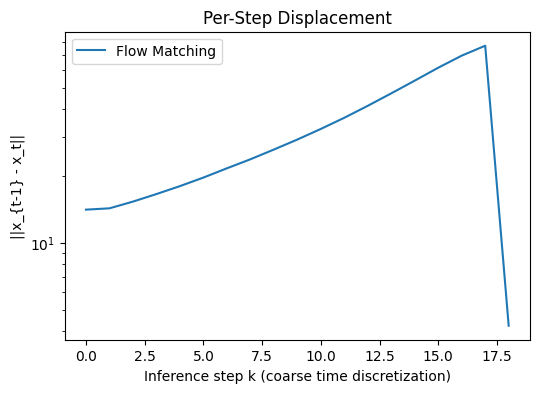

In [201]:
plt.figure(figsize=(6,4))

plt.plot(step_displacements(traj_sd3), label="Flow Matching")
plt.yscale("log")
plt.xlabel("Inference step k (coarse time discretization)")
plt.ylabel("||x_{t-1} - x_t||")
plt.legend()
plt.title("Per-Step Displacement")
plt.show()



#### Diffusion-Based Models (DDPM, DDIM, Latent Diffusion)

The graph above shows the behavior as below:
- **DDPM** shows the largest displacement which aligns with the stochastic nature of the DDPMs.
- **DDIM** shows much smaller steps due to the deterministic nature.
- **Latent diffusion** is slightly higher than DDIM due to the latent space where it operates while also benefiting from the diffusion process.

Results also show that they do many corrective steps until they reach x_0 which is the resulted image.
---

### Flow Matching (Stable Diffusion 3)

For flow matching, it behaves fundamentally differently as it relies on learning the continous velocity field and integrates an ODE.

Due to hardware constraints, the flow matching model here was run with **only 20 inference steps**. Each step therefore corresponds to a **large interval in diffusion time**, making direct comparison with diffusion models **not strictly fair**.

This analysis shows how generative models move in latent spaces during the generation process.

## Directional Alignment

### Directional Alignment of Inference Steps

In this experiment, we study how each inference step is consistent with the **global direction of the denoising trajectory**.

Let $x_t$ denote the latent tensor at diffusion time $t$, with shape $(C, H, W)$.

---

**Global direction of the trajectory:**

$$
d_{\text{global}} = \frac{x_0 - x_T}{\|x_0 - x_T\|_2}
$$

---

**Local step direction at inference step $k$:**

$$
d_k = \frac{x_{t-1} - x_t}{\|x_{t-1} - x_t\|_2}
$$

---

**Directional alignment at step $k$:**

$$
\text{alignment}(k) = \langle d_k,\; d_{\text{global}} \rangle
$$

which is equivalently written as:

$$
\text{alignment}(k)
=
\frac{\langle x_{t-1} - x_t,\; x_0 - x_T \rangle}
{\|x_{t-1} - x_t\|_2 \cdot \|x_0 - x_T\|_2}
$$

---

This experiment therefore reveals **structural differences in the inference trajectories** across diffusion-based and flow-based generative models.


In [205]:
def directional_alignment(traj, eps=1e-8):
    
    traj = traj.squeeze(1)   # (T, C, H, W)

    
    global_dir = traj[-1] - traj[0]  # (C, H, W)
    global_dir = global_dir / (
        torch.linalg.vector_norm(global_dir) + eps
    )

    aligns = []

    for k in range(len(traj) - 1):
        step = traj[k + 1] - traj[k]  # (C, H, W)
        step = step / (
            torch.linalg.vector_norm(step) + eps
        )

        # Dot product over (C, H, W)
        align = (step * global_dir).sum()
        aligns.append(align.item())

    return torch.tensor(aligns)


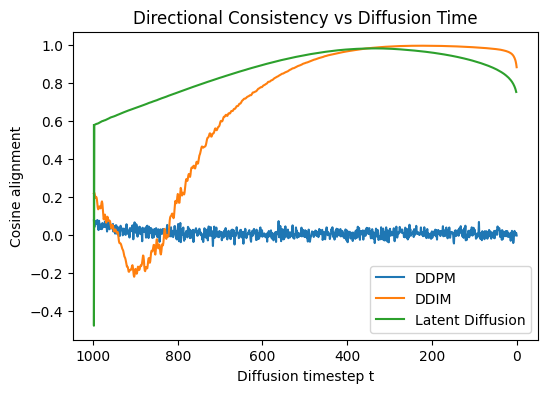

In [212]:
align_ddpm = directional_alignment(traj_ddpm)
align_ddim = directional_alignment(traj_ddim)
align_latent = directional_alignment(traj_latent)

# alignment(k) corresponds to step from x_k → x_{k+1}, so use timesteps[1:]
t_ddpm = timesteps_ddpm[1:]
t_ddim = timesteps_ddim[1:]
t_latent = timesteps_latent[1:]

plt.figure(figsize=(6,4))
plt.plot(t_ddpm, align_ddpm, label="DDPM")
plt.plot(t_ddim, align_ddim, label="DDIM")
plt.plot(t_latent, align_latent, label="Latent Diffusion")

plt.gca().invert_xaxis()   # show large t → small t
plt.xlabel("Diffusion timestep t")
plt.ylabel("Cosine alignment")
plt.legend()
plt.title("Directional Consistency vs Diffusion Time")
plt.show()


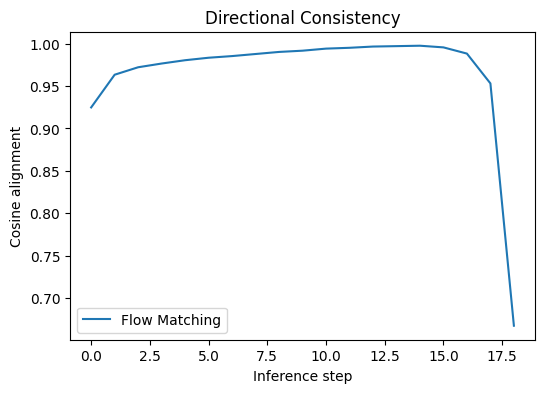

In [207]:
plt.figure(figsize=(6,4))
plt.plot(directional_alignment(traj_sd3), label="Flow Matching")

plt.xlabel("Inference step")
plt.ylabel("Cosine alignment")
plt.legend()
plt.title("Directional Consistency")
plt.show()


**DDPM** exhibits almost zero alignment for the entire trakectory. This aligns with the stochastic random-walk nature of the DDPMs.

**DDIM** shows clear transition into strong positive alignment. At early steps (large t) it shows low alignment but then it increases until it reaches around **1.0** which shows that near the end steps are almost directly toward the final latent.

**Latent Diffusion** shows high alignment across most of the trajectory which shows the benefit of operating in latent space

**Flow matching** The model shows near-perfect directional alignment across all inference steps.

### Curvature of the Path

In this experiment, I try to analyze the curvature of the latent trajectory and how it evolves over time.

Let the reverse inference trajectory be:

$$
x_T \;\rightarrow\; x_{T-1} \;\rightarrow\; \dots \;\rightarrow\; x_0
$$

We define the **discrete second-order difference** of the trajectory as:

$$
x_{t-1} - 2x_t + x_{t+1}
$$

This quantity is a proxy of the **second derivative** of the latent trajectory with respect to inference time.


The **trajectory curvature** at step \( t \) is defined as the Euclidean norm of this second difference:

$$
\kappa(t) = \left\| x_{t-1} - 2x_t + x_{t+1} \right\|_2
$$



In [117]:
def trajectory_curvature(traj):
    
    second_diff = traj[2:] - 2 * traj[1:-1] + traj[:-2]
   

    curvature = torch.linalg.vector_norm(
        second_diff, dim=(2, 3, 4)
    )  

    return curvature.squeeze(1)  


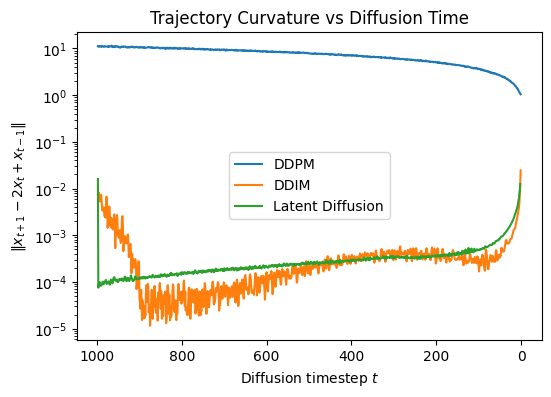

In [213]:
plt.figure(figsize=(6, 4))

# DDPM
curv_ddpm = trajectory_curvature(traj_ddpm)
t_ddpm = timesteps_ddpm[1:-1]   # curvature aligns with x_{t+1}, x_t, x_{t-1}
plt.plot(t_ddpm, curv_ddpm, label="DDPM")

# DDIM
curv_ddim = trajectory_curvature(traj_ddim)
t_ddim = timesteps_ddim[1:-1]
plt.plot(t_ddim, curv_ddim, label="DDIM")

# Latent Diffusion
curv_latent = trajectory_curvature(traj_latent)
t_latent = timesteps_latent[1:-1]
plt.plot(t_latent, curv_latent, label="Latent Diffusion")

plt.yscale("log")
plt.xlabel("Diffusion timestep $t$")
plt.ylabel(r"$\|x_{t+1} - 2x_t + x_{t-1}\|$")
plt.title("Trajectory Curvature vs Diffusion Time")
plt.legend()

# Optional: make time flow from T → 0 (diffusion convention)
plt.gca().invert_xaxis()

plt.show()


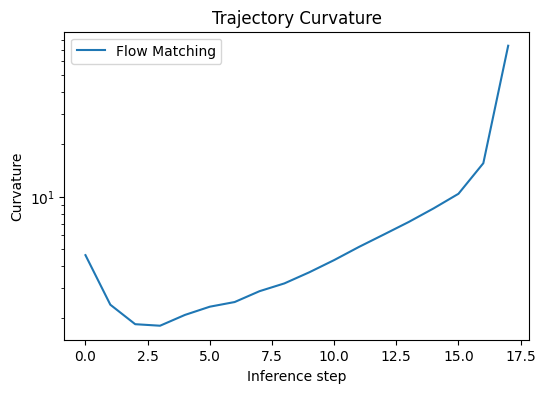

In [119]:
plt.figure(figsize=(6,4))
plt.plot(trajectory_curvature(traj_sd3), label="Flow Matching")
plt.yscale("log")
plt.xlabel("Inference step")
plt.ylabel("Curvature")
plt.legend()
plt.title("Trajectory Curvature")
plt.show()


- **DDPM** shows **high curvature** which shows the stochastic nature of DDPM sampling. 

- **DDIM** shows **lower curvature** which comes consistent with the DDIM deterministic formulation for a smoother path.

- **Latent Diffusion** shows low curvature which shows the smooth and stable path.

- **Flow Matching** (Due to the same limitation, it's not possible to compare it to other models.)

Trajectory curvature provides a **geometric diagnostic** of inference dynamics:

- **High curvature** → stochastic, corrective, or unstable motion  
- **Low curvature** → smooth, direct transport along a learned flow

### Normalized Trajectory Length



In this experiment, we refine the notion of trajectory length by normalizing it with respect to the dimensionality of the space/
---

#### Definition

Let each latent \( x_t \in \mathbb{R}^{C \times H \times W} \), and define the latent dimensionality as:

$$
D = C \cdot H \cdot W
$$

We define the **normalized trajectory length** as:

$$
L_{\text{norm}} = \frac{1}{D} \sum_t \left\| x_{t-1} - x_t \right\|_2
$$

This quantity can be interpreted as the **average displacement per latent dimension** throughout the inference.

- **Large normalized length** shows inefficient trajectories, where there are unnecessary movements.
- **Small normalized length** shows direct and efficient movement towards the target distribution.



In [120]:
def normalized_length(traj):
   
    _, _, C, H, W = traj.shape
    D = C * H * W
    return trajectory_length(traj) / D


In [259]:


summary = pd.DataFrame({
    "Model": ["DDPM", "DDIM", "Latent Diffusion","Flow Matching"],
    "Path Length": [
        normalized_length(traj_ddpm),
        normalized_length(traj_ddim),
        normalized_length(traj_latent),
        normalized_length(traj_sd3),
    ],
    "Mean Curvature": [
        trajectory_curvature(traj_ddpm).mean().item(),
        trajectory_curvature(traj_ddim).mean().item(),
        trajectory_curvature(traj_latent).mean().item(),
        trajectory_curvature(traj_sd3).mean().item()
    ],
    "Mean Alignment": [
        directional_alignment(traj_ddpm).mean().item(),
        directional_alignment(traj_ddim).mean().item(),
        directional_alignment(traj_latent).mean().item(),
        directional_alignment(traj_sd3).mean().item()
    ]
})

summary


,Model,Path Length,Mean Curvature,Mean Alignment
0,DDPM,1.713121,7.463598,0.010756
1,DDIM,0.018446,0.000484,0.679072
2,Latent Diffusion,0.005403,0.000403,0.861959
3,Flow Matching,0.002378,8.796875,0.965306


The table above presents a summary comparing **DDPM**, **DDIM**, and **Latent Diffusion** by 
- **Normalized Path Length**
- **Mean Curvature**
- **Mean Directional Alignment**



### Normalized Path Length


- **DDPM** shows a **much larger** path length which shows a long and inefficient trajectory due to its stochastic nature.

- **DDIM** reduces the path length **significantly** which shows more direct path to the final sample.
- **Latent Diffusion** achieves the shortest path overall when the path length is normalized.

### Mean Curvature



- **DDPM** has extremely high curvature.
- **DDIM** and **Latent Diffusion** show lower curvature values.


### Mean Directional Alignment

Mean alignment measures how consistently each step aligns with the **global denoising direction** from noise to data.

- **DDPM** has near-zero alignment on average.
- **DDIM** shows strong positive alignment.
- **Latent Diffusion** achieves the highest alignment among all models.


### Overall Takeaway

These results reveal clear structural differences in inference dynamics:

- **DDPM** has stochastic exploration with a random-walk nature which affects its trajectory.
- **DDIM** significantly improves efficiency by making it deterministic and removing stochasticity.
- **Latent Diffusion** makes efficient use of the latent space in the generation process.



## Pixel / Latent-Dimension Trajectories

In this experiment, I tried to track the evolution of a **single latent coordinate** \((c, h, w)\) throughout the generation process. I tried to analyze the scalar trajectory:
$$
x_t^{(c,h,w)} \quad \text{for} \quad t = T, T-1, \dots, 0
$$

In [122]:
def extract_pixel_trajectory(intermediates, c=0, h=0, w=0):
    values = []
    timesteps = []

    for step in intermediates:
        latent = step["latent"]  # (1, C, H, W)
        values.append(latent[0, c, h, w].item())
        timesteps.append(step["timestep"])

    return torch.tensor(values), torch.tensor(timesteps)


In [123]:
c, h, w = 1, 16, 16  


In [124]:
vals_ddpm, ts_ddpm = extract_pixel_trajectory(intermediates_DDPM, c, h, w)
vals_ddim, ts_ddim = extract_pixel_trajectory(intermediates_DDIM, c, h, w)
vals_latent,ts_latent=extract_pixel_trajectory(intermediates_latent_diffusion,c,h,w)


In [216]:
ts_ddim

tensor([999, 998, 997, 996, 995, 994, 993, 992, 991, 990, 989, 988, 987, 986,
        985, 984, 983, 982, 981, 980, 979, 978, 977, 976, 975, 974, 973, 972,
        971, 970, 969, 968, 967, 966, 965, 964, 963, 962, 961, 960, 959, 958,
        957, 956, 955, 954, 953, 952, 951, 950, 949, 948, 947, 946, 945, 944,
        943, 942, 941, 940, 939, 938, 937, 936, 935, 934, 933, 932, 931, 930,
        929, 928, 927, 926, 925, 924, 923, 922, 921, 920, 919, 918, 917, 916,
        915, 914, 913, 912, 911, 910, 909, 908, 907, 906, 905, 904, 903, 902,
        901, 900, 899, 898, 897, 896, 895, 894, 893, 892, 891, 890, 889, 888,
        887, 886, 885, 884, 883, 882, 881, 880, 879, 878, 877, 876, 875, 874,
        873, 872, 871, 870, 869, 868, 867, 866, 865, 864, 863, 862, 861, 860,
        859, 858, 857, 856, 855, 854, 853, 852, 851, 850, 849, 848, 847, 846,
        845, 844, 843, 842, 841, 840, 839, 838, 837, 836, 835, 834, 833, 832,
        831, 830, 829, 828, 827, 826, 825, 824, 823, 822, 821, 8

In [215]:
ts_ddpm

tensor([999, 998, 997, 996, 995, 994, 993, 992, 991, 990, 989, 988, 987, 986,
        985, 984, 983, 982, 981, 980, 979, 978, 977, 976, 975, 974, 973, 972,
        971, 970, 969, 968, 967, 966, 965, 964, 963, 962, 961, 960, 959, 958,
        957, 956, 955, 954, 953, 952, 951, 950, 949, 948, 947, 946, 945, 944,
        943, 942, 941, 940, 939, 938, 937, 936, 935, 934, 933, 932, 931, 930,
        929, 928, 927, 926, 925, 924, 923, 922, 921, 920, 919, 918, 917, 916,
        915, 914, 913, 912, 911, 910, 909, 908, 907, 906, 905, 904, 903, 902,
        901, 900, 899, 898, 897, 896, 895, 894, 893, 892, 891, 890, 889, 888,
        887, 886, 885, 884, 883, 882, 881, 880, 879, 878, 877, 876, 875, 874,
        873, 872, 871, 870, 869, 868, 867, 866, 865, 864, 863, 862, 861, 860,
        859, 858, 857, 856, 855, 854, 853, 852, 851, 850, 849, 848, 847, 846,
        845, 844, 843, 842, 841, 840, 839, 838, 837, 836, 835, 834, 833, 832,
        831, 830, 829, 828, 827, 826, 825, 824, 823, 822, 821, 8

In [125]:
vals_fm,   ts_fm   = extract_pixel_trajectory(intermediates_sd3,   c, h, w)

In [218]:
len(vals_ddpm)

1000

In [219]:
len(t_ddpm)

998

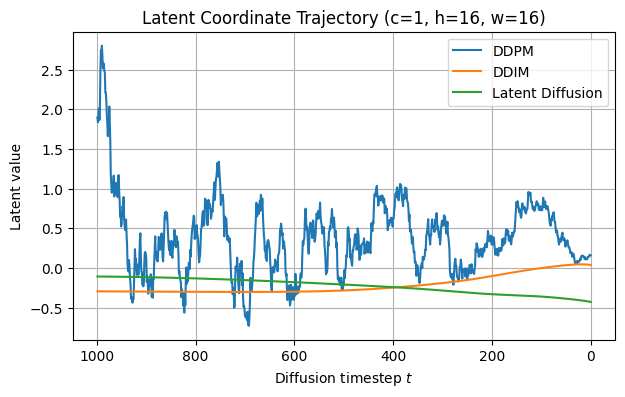

In [223]:
T = len(vals_ddpm) - 1
t_axis = torch.linspace(T, 0, steps=len(vals_ddpm))

plt.figure(figsize=(7, 4))

plt.plot(t_axis, vals_ddpm, label="DDPM")
plt.plot(t_axis, vals_ddim, label="DDIM")
plt.plot(t_axis, vals_latent, label="Latent Diffusion")

plt.xlabel("Diffusion timestep $t$")
plt.ylabel("Latent value")
plt.title(f"Latent Coordinate Trajectory (c={c}, h={h}, w={w})")

plt.gca().invert_xaxis()   

plt.legend()
plt.grid(True)
plt.show()


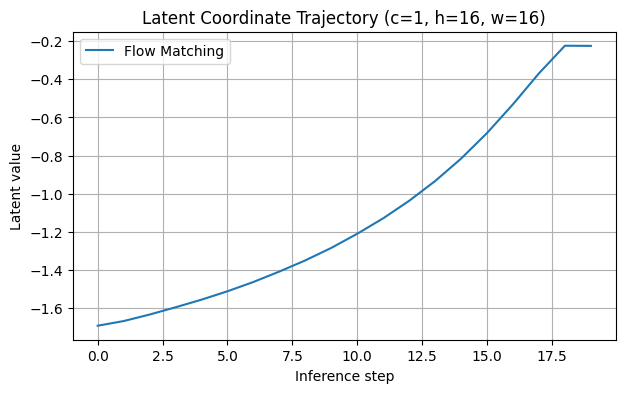

In [127]:
plt.figure(figsize=(7,4))

plt.plot(vals_fm, label="Flow Matching")

plt.xlabel("Inference step")
plt.ylabel("Latent value")
plt.title(f"Latent Coordinate Trajectory (c={c}, h={h}, w={w})")
plt.legend()
plt.grid(True)
plt.show()


**DDPM:**
- Again, there is high oscillation-nature throughout the generation process which reflects the stochastic nature of the generation process.
**DDIM:**
- This shows a significantly smoother trajectory than DDPM due to its deterministic generation process.
**Latent Diffusion:**
- The evolution here appears in a very stable manner. This shows the benefit of operating in a compressed latent space.
**Flow Matching:**
- The analysis, despite being on low number of steps, show a smooth and monotonic nature which shows the consistent and direct nature of this type of models.



### Takeaway
While all models converge to the same sample, this is done through **fundamentally different latent dynamics**.


## Dynamically Visualize image vs step number

In this section, I tried to provide an **interactive visualization** of how the image (intermediate samples change) during the generation process.

The slider is just to change the step number and accordingly show how the sample change over time.

This interactive view complements the quantitative analysis done earlier.


### DDPM

In [128]:
def decode_cifar_latent(latent):
    img = latent.detach().cpu()
    img = (img + 1) / 2
    img = img.clamp(0, 1)
    img = img[0].permute(1, 2, 0).numpy()
    return img


In [129]:
def interactive_viewer(intermediates):
    max_step = len(intermediates) - 1

    def show(step):
        latent = intermediates[step]["latent"]
        timestep = intermediates[step]["timestep"]

        img = decode_cifar_latent(latent)

        plt.figure(figsize=(4,4))
        plt.imshow(img)
        plt.axis("off")
        plt.title(f"Step {step} | Timestep {timestep}")
        plt.show()

    interact(
        show,
        step=IntSlider(min=0, max=max_step, step=1, value=0)
    )



In [ ]:
interactive_viewer(intermediates_DDPM)


interactive(children=(IntSlider(value=0, description='step', max=999), Output()), _dom_classes=('widget-intera…

### DDIM

In [ ]:
interactive_viewer(intermediates_DDIM)

interactive(children=(IntSlider(value=0, description='step', max=999), Output()), _dom_classes=('widget-intera…

### Latent Diffusion

In [132]:
def decode_sd_latent(latent, vae):
    latent = latent / vae.config.scaling_factor
    with torch.no_grad():
        img = vae.decode(latent).sample
    img = (img + 1) / 2
    img = img.clamp(0, 1)
    img = img[0].permute(1, 2, 0).cpu().numpy()
    return img


In [133]:
def interactive_viewer_sd(intermediates, vae):
    max_step = len(intermediates) - 1

    def show(step):
        latent = intermediates[step]["latent"]
        timestep = intermediates[step]["timestep"]

        img = decode_sd_latent(latent, vae)

        plt.figure(figsize=(5,5))
        plt.imshow(img)
        plt.axis("off")
        plt.title(f"Step {step} | Timestep {timestep}")
        plt.show()

    interact(
        show,
        step=IntSlider(min=0, max=max_step, step=1, value=0)
    )


In [134]:
stable_diffusion2=Stable_Diffusion_Loader(device="cpu")

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [135]:
interactive_viewer_sd(intermediates_latent_diffusion, stable_diffusion2.vae)


interactive(children=(IntSlider(value=0, description='step', max=999), Output()), _dom_classes=('widget-intera…

### Dynamic Visualization with trajectory

In [136]:
def interactive_with_metric(intermediates, traj, metric):
    max_step = len(intermediates) - 1

    def show(step):
        latent = intermediates[step]["latent"]
        img = decode_cifar_latent(latent)

        fig, axs = plt.subplots(1, 2, figsize=(8,4))

        axs[0].imshow(img)
        axs[0].axis("off")
        axs[0].set_title(f"Step {step}")

        axs[1].plot(metric)
        axs[1].axvline(step, color="red")
        axs[1].set_title("Step Displacement")

        plt.show()

    interact(
        show,
        step=IntSlider(min=0, max=max_step, step=1, value=0)
    )


In [137]:
metric = step_displacements(traj_ddpm)
interactive_with_metric(intermediates_DDPM, traj_ddpm, metric)


interactive(children=(IntSlider(value=0, description='step', max=999), Output()), _dom_classes=('widget-intera…

In [139]:
metric_ddim = step_displacements(traj_ddim)
interactive_with_metric(intermediates_DDIM, traj_ddim, metric_ddim)


interactive(children=(IntSlider(value=0, description='step', max=999), Output()), _dom_classes=('widget-intera…

In [140]:
def decode_sd_latent(latent, vae):
    latent = latent / vae.config.scaling_factor
    with torch.no_grad():
        img = vae.decode(latent).sample

    img = (img + 1) / 2
    img = img.clamp(0, 1)
    img = img[0].permute(1, 2, 0).cpu().numpy()
    return img


In [141]:
def interactive_with_metric_sd(intermediates, traj, metric, vae):
    max_step = len(intermediates) - 1

    def show(step):
        latent = intermediates[step]["latent"]
        timestep = intermediates[step]["timestep"]

        img = decode_sd_latent(latent, vae)

        fig, axs = plt.subplots(1, 2, figsize=(10, 4))

        # Image
        axs[0].imshow(img)
        axs[0].axis("off")
        axs[0].set_title(f"Latent Diffusion | step {step} | t={timestep}")

        # Metric
        axs[1].plot(metric)
        axs[1].axvline(step, color="red")
        axs[1].set_title("Step displacement")
        axs[1].set_xlabel("Inference step")

        plt.show()

    interact(
        show,
        step=IntSlider(min=0, max=max_step, step=1, value=0)
    )


In [142]:
metric_sd = step_displacements(traj_latent)
interactive_with_metric_sd(
    intermediates_latent_diffusion,
    traj_latent,
    metric_sd,
    stable_diffusion2.vae
)


interactive(children=(IntSlider(value=0, description='step', max=999), Output()), _dom_classes=('widget-intera…

### RGB Trajectory of center pixel

In this experiment, I try to track the **RGB values of the center pixel** across inference steps for different generative models.


### DDPM

In [224]:
print(intermediates_DDPM[0]['latent'].shape)

torch.Size([1, 3, 32, 32])


In [225]:

traj_ddpm = torch.stack([s["latent"] for s in intermediates_DDPM])  
traj_ddpm = traj_ddpm.squeeze(1)  


In [226]:
print(traj_ddpm.shape)

torch.Size([1000, 3, 32, 32])


In [227]:
i, j = 16, 16  # center pixel


In [228]:
pixel_traj = traj_ddpm[:, :, i, j]   # shape: (T, 3)


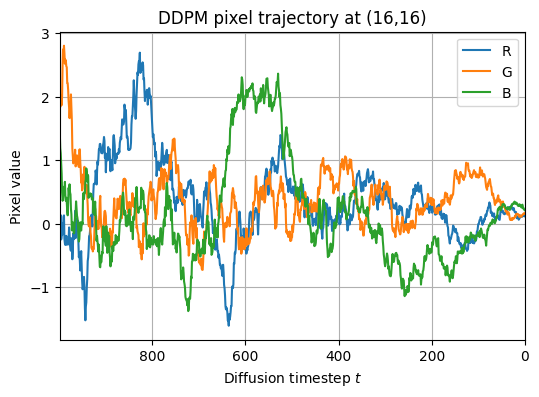

In [ ]:
import torch
import matplotlib.pyplot as plt

T = len(pixel_traj) - 1          # e.g. 1000
t_axis = torch.linspace(T, 0, steps=len(pixel_traj))

plt.figure(figsize=(6,4))

plt.plot(t_axis, pixel_traj[:, 0], label="R")
plt.plot(t_axis, pixel_traj[:, 1], label="G")
plt.plot(t_axis, pixel_traj[:, 2], label="B")

plt.xlabel("Diffusion timestep $t$")
plt.ylabel("Pixel value")
plt.title("DDPM pixel trajectory at (16,16)")
plt.legend()
plt.grid(True)


plt.xlim(T, 0)

plt.show()


### DDIM

In [239]:

traj_ddim = torch.stack([s["latent"] for s in intermediates_DDIM])  
traj_ddim = traj_ddim.squeeze(1) 
print(traj_ddim.shape)
i, j = 16, 16  # center pixel
pixel_traj = traj_ddim[:, :, i, j]   # shape: (T, 3)


torch.Size([1000, 3, 32, 32])


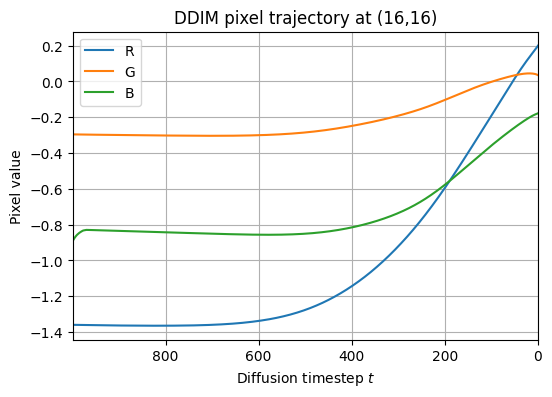

In [ ]:


T = len(pixel_traj) - 1          # e.g. 1000
t_axis = torch.linspace(T, 0, steps=len(pixel_traj))

plt.figure(figsize=(6,4))

plt.plot(t_axis, pixel_traj[:, 0], label="R")
plt.plot(t_axis, pixel_traj[:, 1], label="G")
plt.plot(t_axis, pixel_traj[:, 2], label="B")

plt.xlabel("Diffusion timestep $t$")
plt.ylabel("Pixel value")
plt.title("DDIM pixel trajectory at (16,16)")
plt.legend()
plt.grid(True)


plt.xlim(T, 0)

plt.show()


### Latent Diffusion

In [242]:

traj_latent = torch.stack([s["latent"] for s in intermediates_latent_diffusion])  
traj_latent = traj_latent.squeeze(1) 



In [243]:
print(traj_latent.shape)

torch.Size([1000, 4, 64, 64])


In [244]:
i, j = 32, 32  # center pixel
pixel_traj = traj_latent[:, :, i, j]   # shape: (T, 3)

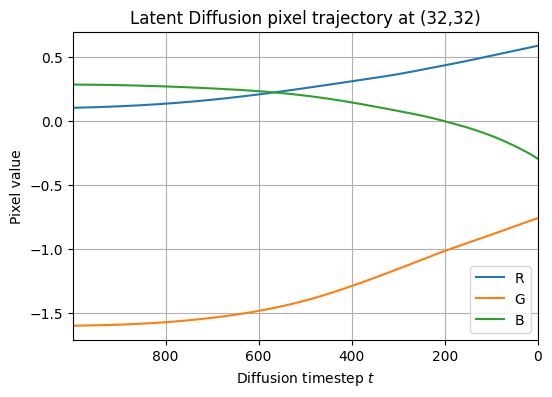

In [246]:

T = len(pixel_traj) - 1          
t_axis = torch.linspace(T, 0, steps=len(pixel_traj))

plt.figure(figsize=(6,4))

plt.plot(t_axis, pixel_traj[:, 0], label="R")
plt.plot(t_axis, pixel_traj[:, 1], label="G")
plt.plot(t_axis, pixel_traj[:, 2], label="B")

plt.xlabel("Diffusion timestep $t$")
plt.ylabel("Pixel value")
plt.title("Latent Diffusion pixel trajectory at (32,32)")
plt.legend()
plt.grid(True)


plt.xlim(T, 0)

plt.show()


**DDPM**

- The RGB trajectories exhibit **strong stochastic fluctuations** throughout inference.
- Each channel shows great oscillations changing direction and magnitude
- This behavior reflects the **Stochastic nature of DDPM**, where noise at each step is like a random walk.

**DDIM**

- The RGB trajectories are smooth with minimal oscillations
- The results reflect the **deterministic sampling** where the model follows a fixed path without stochasticity.

**Latent Diffusion**

- Similar to DDIM, the trajectories are **smooth and highly structured**.
- Pixel values evolve gradually with consistent curvature and low noise.
- Operating in latent space shows how this leads to clean trajectories.


